### Solution to Project 2 - Advanced Method of finding lanes on the road

The first solution to finding lanes on the road utilised a pipeline which:
1. Reading the raw image into a computable array format (based on RGB encodings)
2. Region masking the images to select only the area of interest
3. Detecting lines using the OpenCV canny edge detection and after applying a custom Gaussian smoothing factor and greyscale 
4. Applying a Hough transform to the edge detected image to select only the lane lines
5. Highligting the lane lines in the image and extrapolating them to the edge of the area of interest


However, it was not a production ready method of processing asit didn't always find the lane lines correctly - and in some cases found incorrect lines. It goes without saying that in the real world this could cause automated navigation systems to crash or be otherwise unreliable.

Below is an updated method for finding correct lane lines based which:
1. Eliminates distortion from the camera
2. Improves lane detection via
    * Analysis based on alternate colour spaces
    * Improved edge detection using Sobel operators
    * Perspective transformation histograms
    * Perspective trasnsformation lane curvature detection
3. Additional optimisations



#### Step 1 - Detecting and eliminating camera distortion

Text(0.5,1,'Undistorted Image')

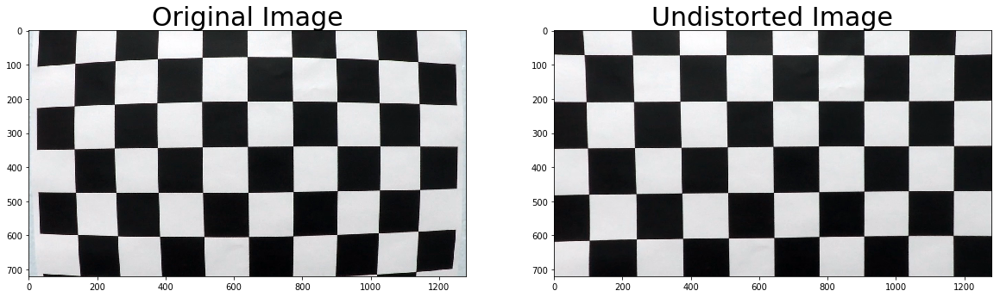

In [3]:
import os
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plot
import matplotlib.image as mpImage
%matplotlib inline

num_col_vertex = 9
num_row_vertex = 6
objp = np.zeros((num_row_vertex*num_col_vertex,3), np.float32)
objp[:,:2] = np.mgrid[0:num_col_vertex, 0:num_row_vertex].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = []
imgpoints = []

# Grab all images for calibration
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (num_col_vertex,num_row_vertex), None)
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        cv2.drawChessboardCorners(img, (num_col_vertex,num_row_vertex), corners, ret)
        cv2.imshow('img', img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

#Output undistorted image using the first image to prove distortion is corrected
img = cv2.imread('camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
dst = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('camera_cal/calibration1_undist.jpg',dst)

# Visualize undistortion
f, (ax1, ax2) = plot.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

#### Step 2a - Detecting lines based on undistorted version of simple pipeline

The intial pipeline has been updated to show the undistorted version of the test images below:

Image straight_lines1.jpg captured in array with dimensions:(720, 1280, 3)


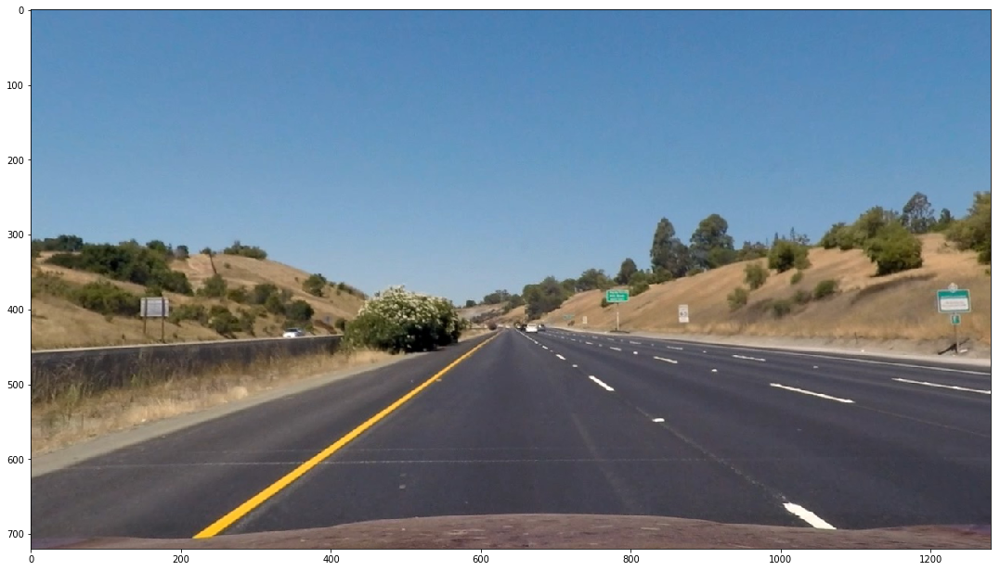

Image straight_lines2.jpg captured in array with dimensions:(720, 1280, 3)


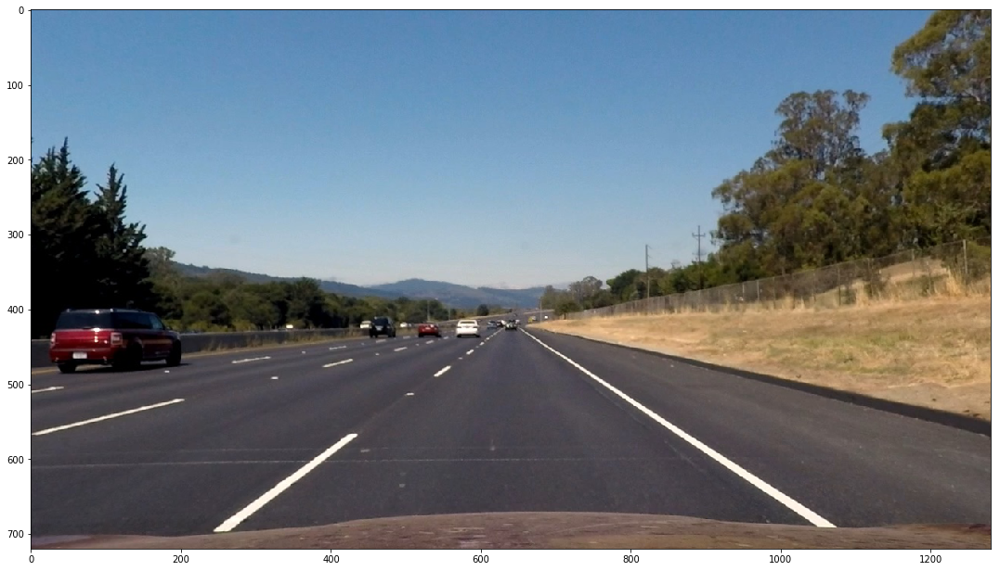

Image test1.jpg captured in array with dimensions:(720, 1280, 3)


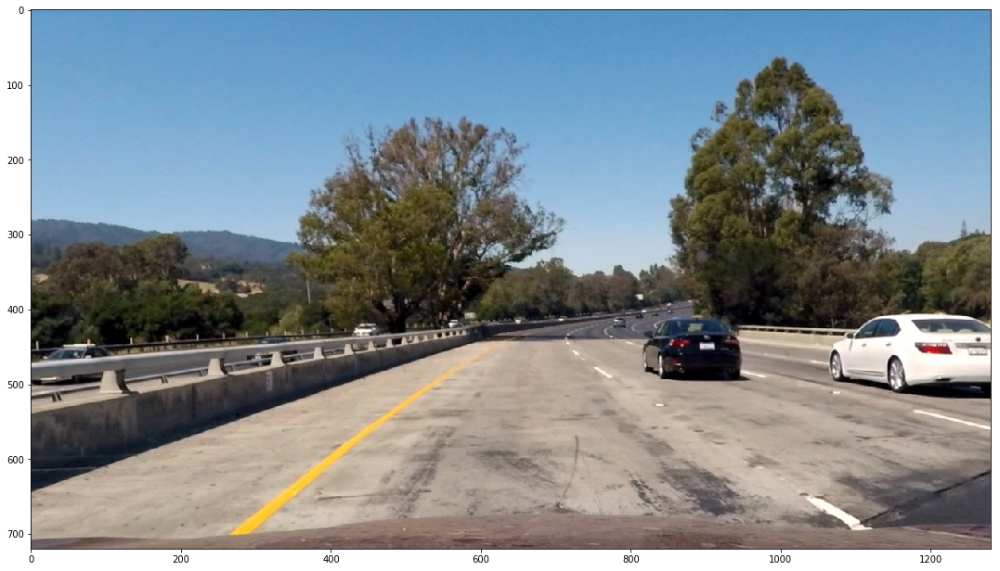

Image test2.jpg captured in array with dimensions:(720, 1280, 3)


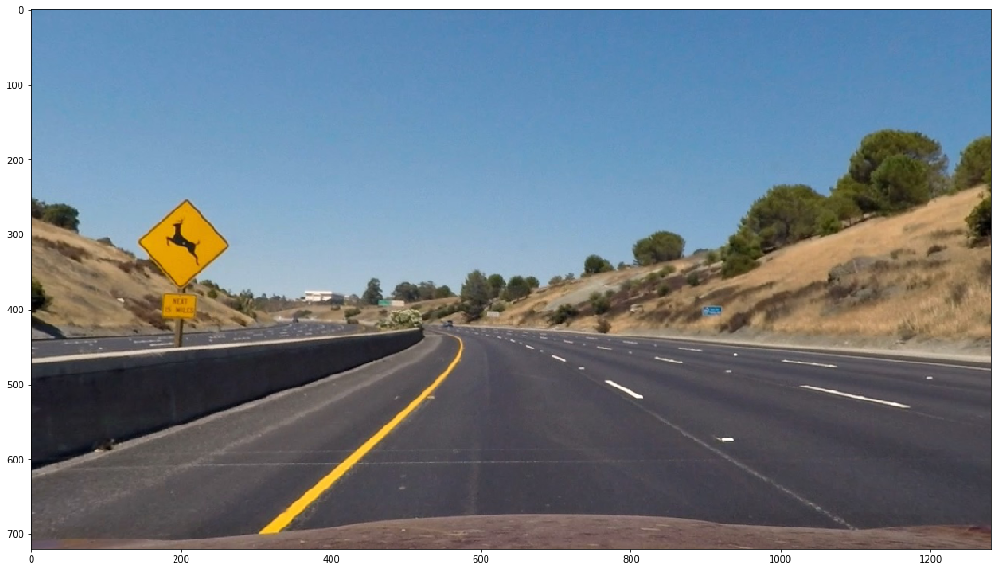

Image test3.jpg captured in array with dimensions:(720, 1280, 3)


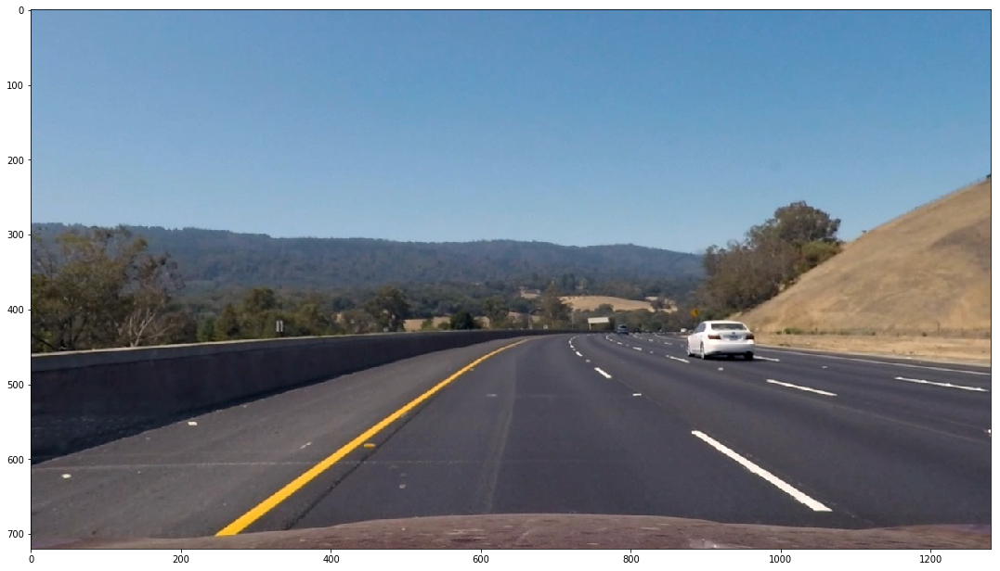

Image test4.jpg captured in array with dimensions:(720, 1280, 3)


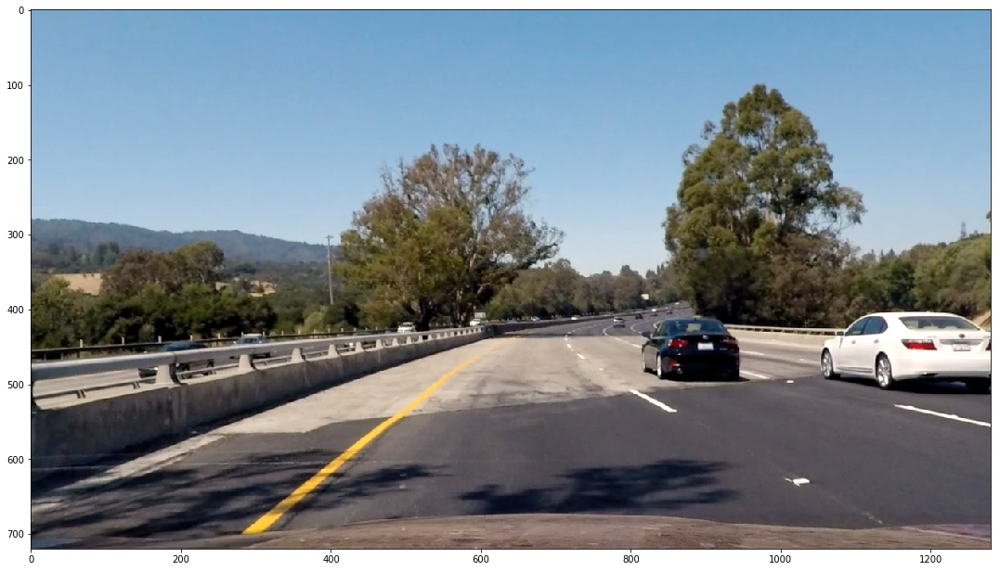

Image test5.jpg captured in array with dimensions:(720, 1280, 3)


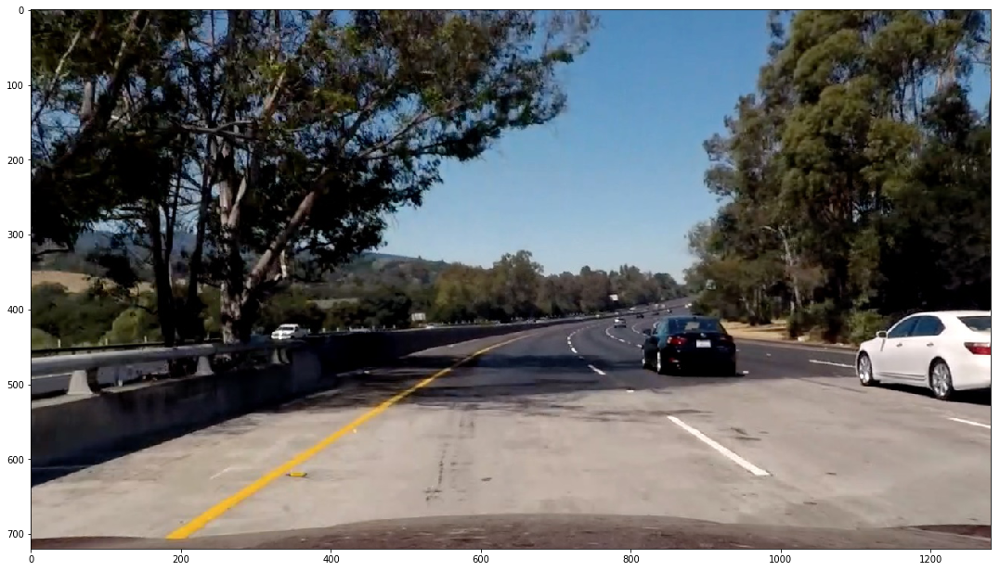

Image test6.jpg captured in array with dimensions:(720, 1280, 3)


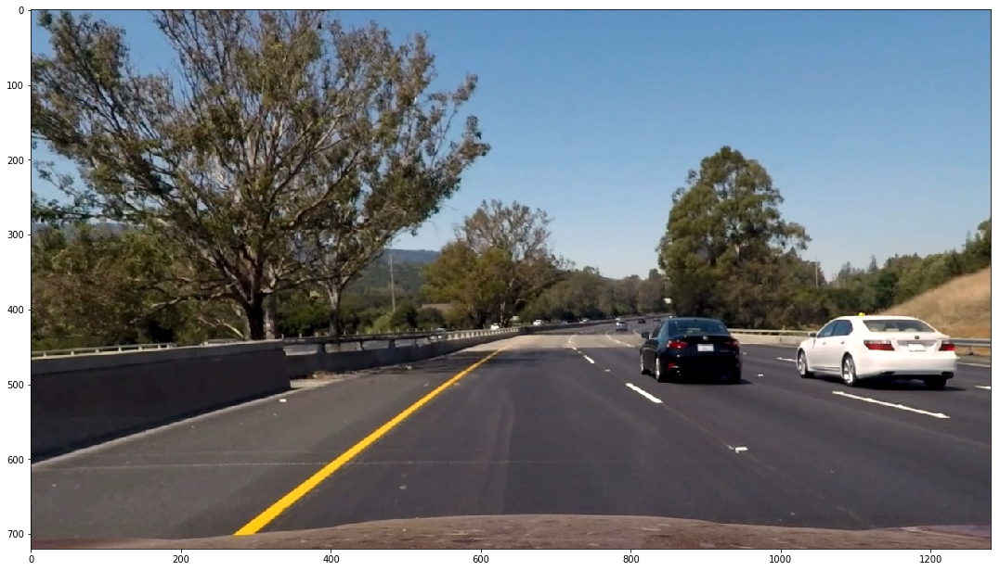

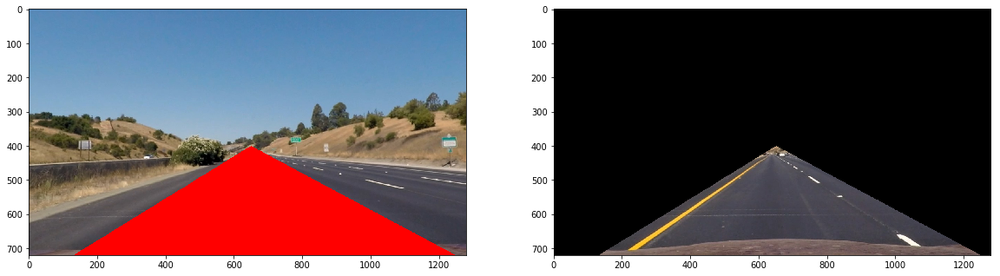

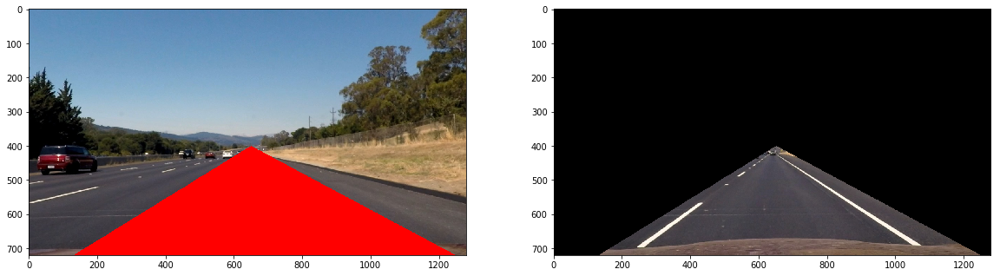

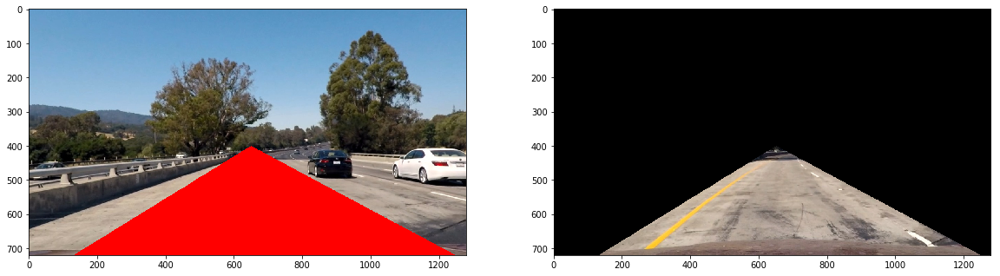

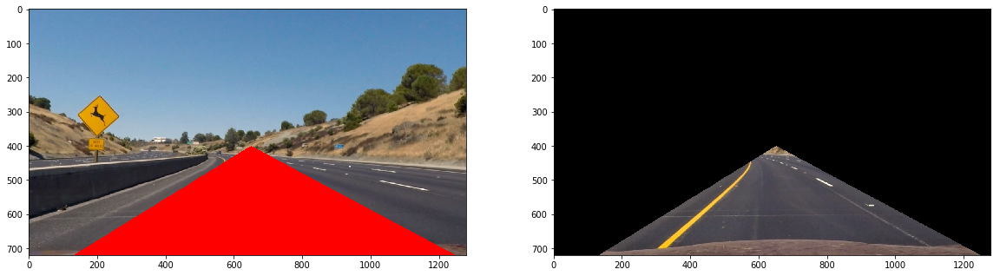

...

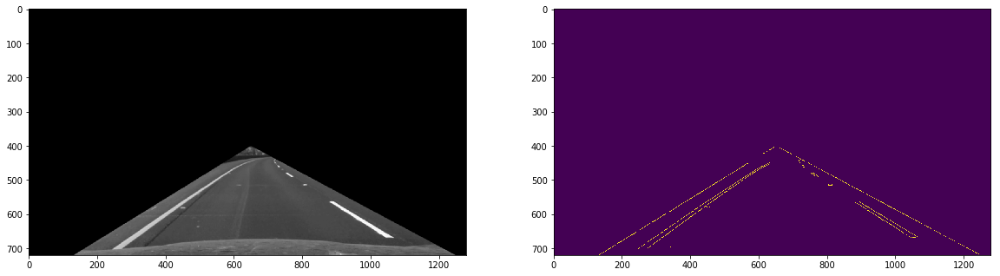

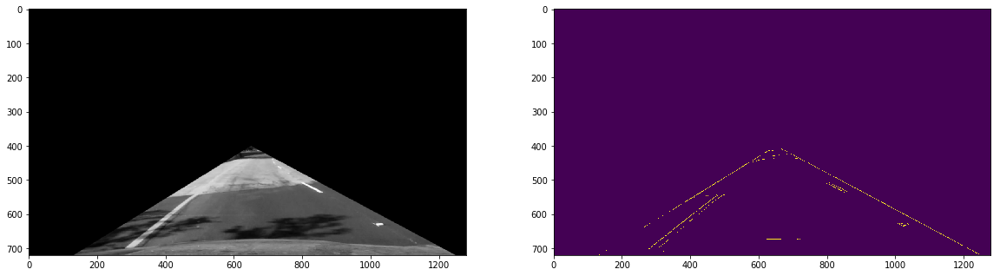

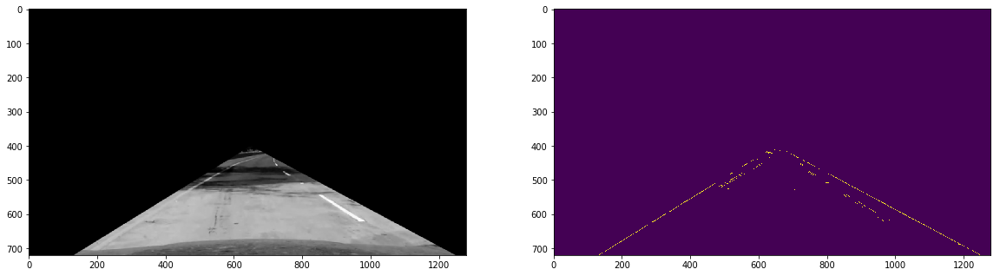

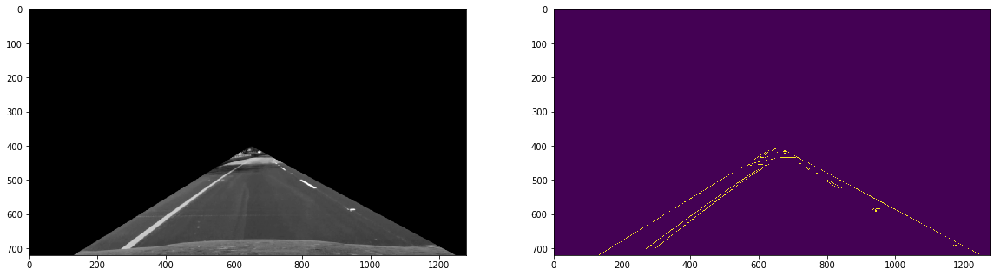

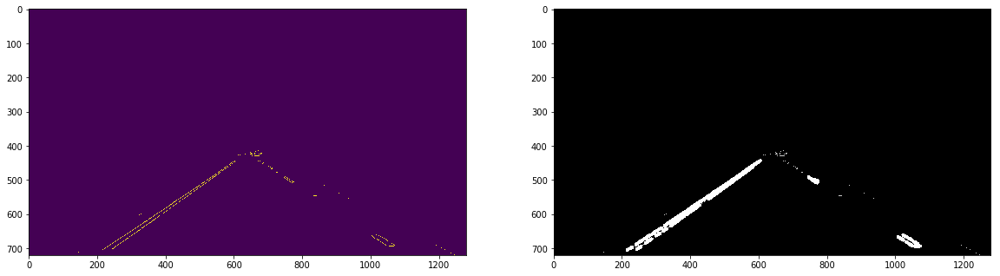

Found 24 lines using the Hough Transform.


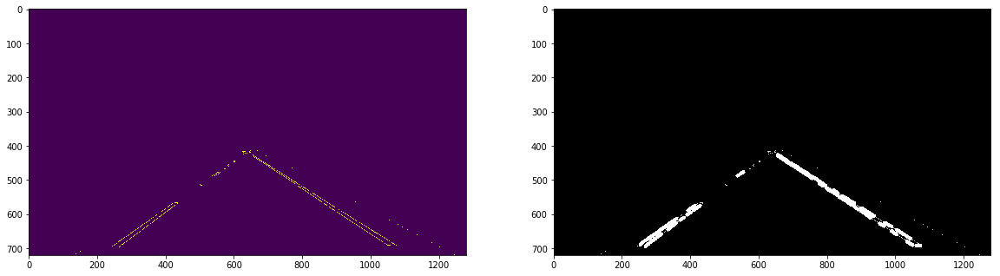

Found 39 lines using the Hough Transform.


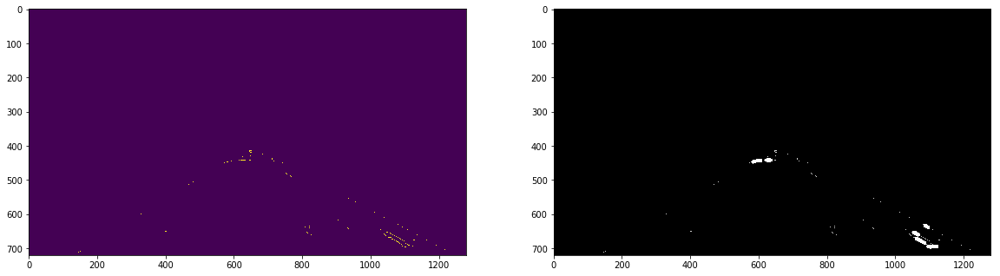

Found 10 lines using the Hough Transform.


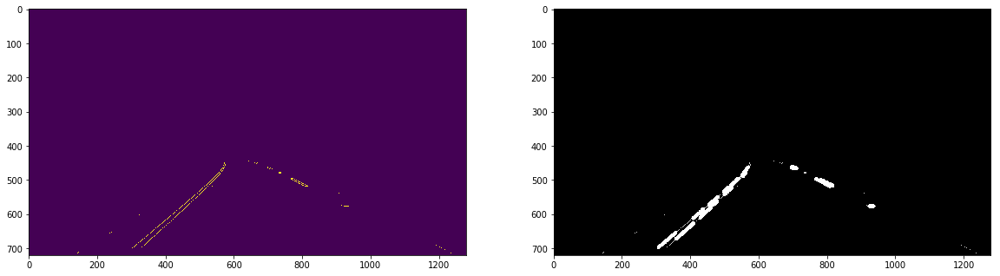

Found 26 lines using the Hough Transform.


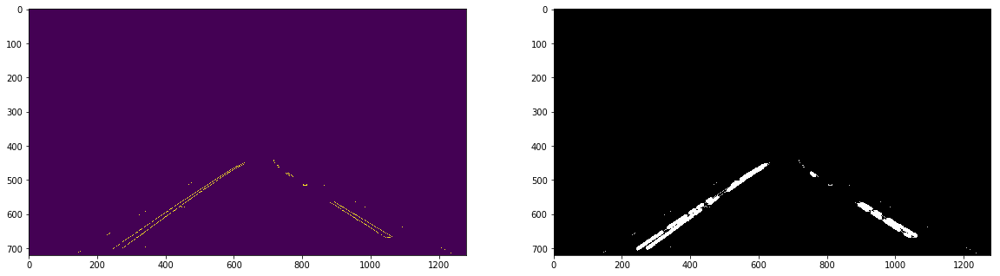

Found 43 lines using the Hough Transform.


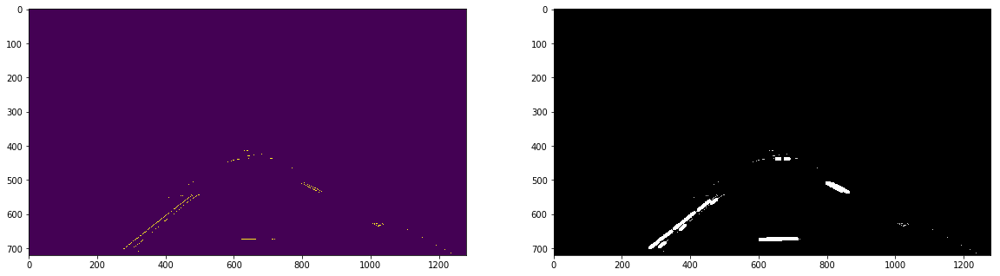

Found 20 lines using the Hough Transform.


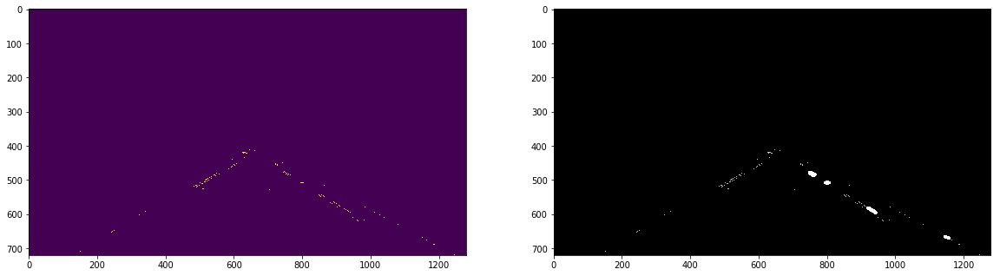

Found 5 lines using the Hough Transform.


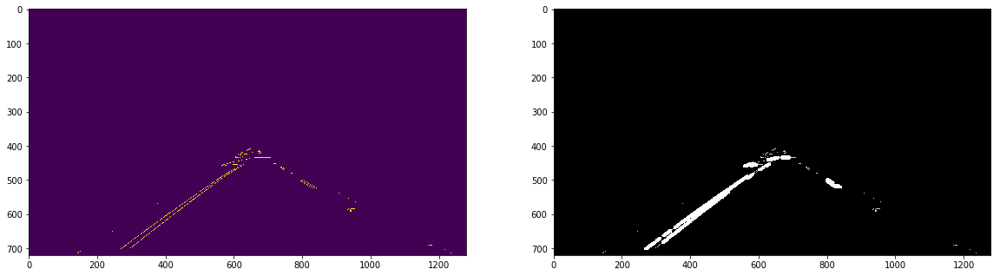

Found 32 lines using the Hough Transform.


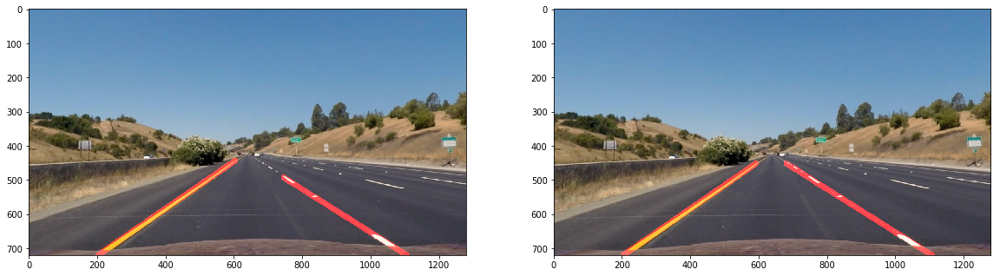

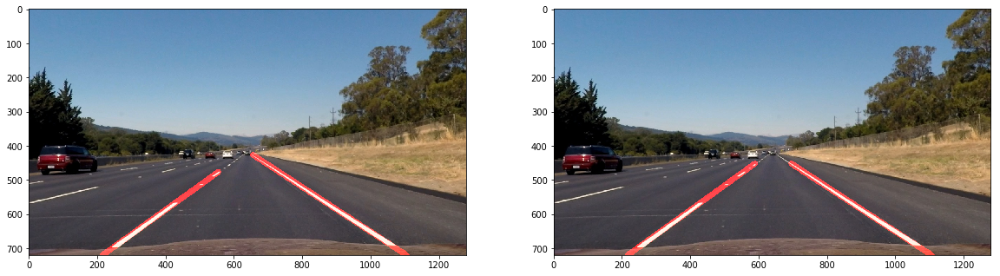

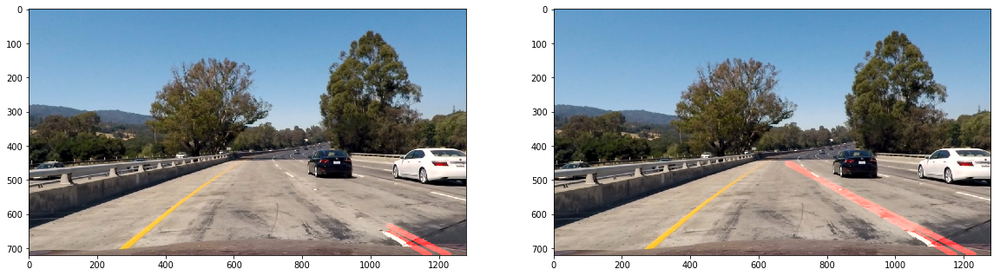

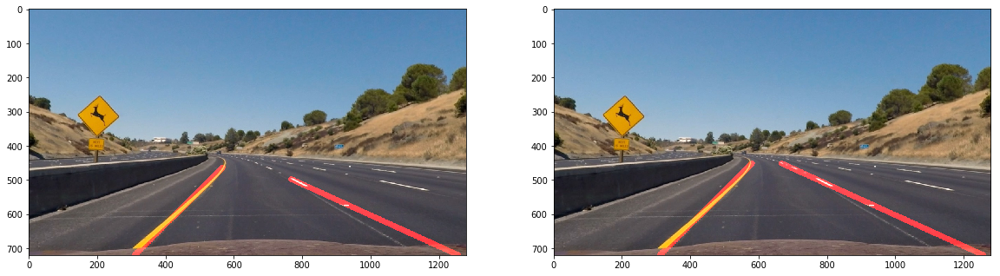

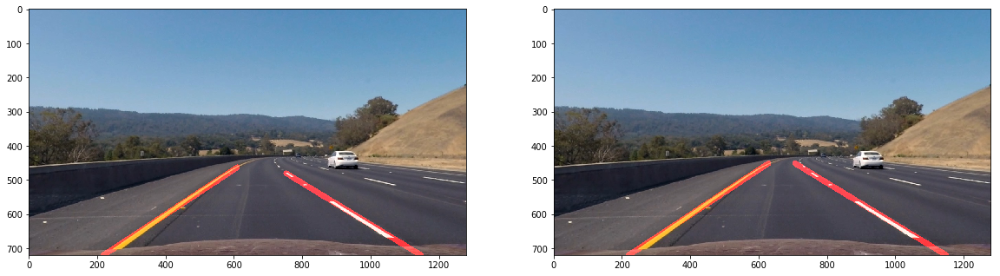

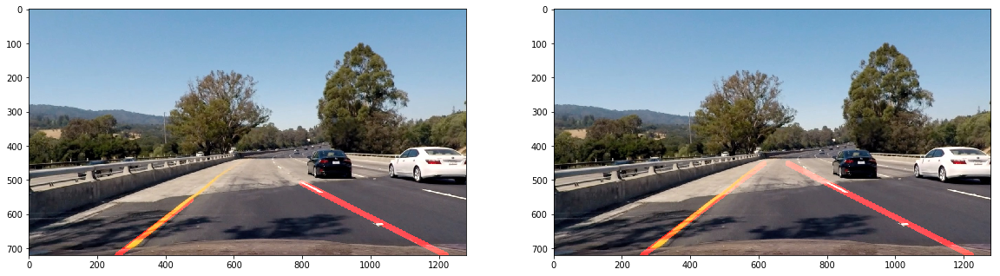

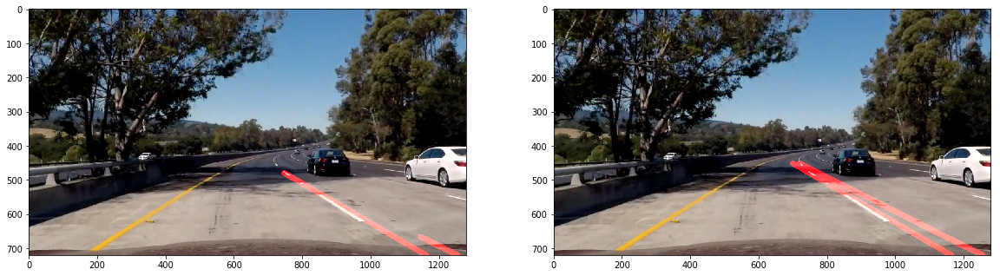

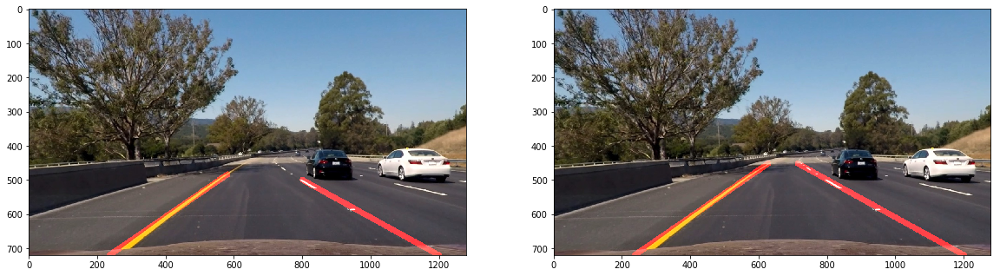

In [12]:
#Read and display static Images with undistortion and perspective transform applied 
#to the area of interest using the simple pipeline from exercise 1

static_image_path = os.getcwd() + '/test_images/'
static_image_path_iterator = os.listdir(static_image_path)
staticImages = []
count = 0
for static_image in static_image_path_iterator:
    staticImages.append(cv2.undistort(mpImage.imread(static_image_path + static_image), mtx, dist, None, mtx))
    print('Image ' + static_image + ' captured in array with dimensions:' + str(staticImages[count].shape))
    plot.imshow(staticImages[count])
    plot.show()
    count = count + 1

#Setup region of interest for images using hard coded points for now
#eventually these can be based on percentages so it scales if the image size changes
region_point_1 = [130,720] 
region_point_2 = [1250,720]
region_point_3 = [650,400]
line_A = np.polyfit((region_point_3[0], region_point_1[0]), (region_point_3[1], region_point_1[1]), 1)
line_B = np.polyfit((region_point_3[0], region_point_2[0]), (region_point_3[1], region_point_2[1]), 1)
line_C = np.polyfit((region_point_1[0], region_point_2[0]), (region_point_1[1], region_point_2[1]), 1)

#now loop through and copy defined images in order to delineate the area of interest
region_masked_images = []
region_highlighted_images = []

iterationImageCount = 0

for image in staticImages:
    (y,x) = (image.shape[0],image.shape[1])

    if (iterationImageCount == 0):
        defaultPlotX = plot.rcParams["figure.figsize"][0] 
        defaultPlotY = plot.rcParams["figure.figsize"][1]
        total_width_inches = (x + 150)/f.dpi
        total_height_inches = (y + 50)/f.dpi
        plot.rcParams["figure.figsize"][0] = total_width_inches
        plot.rcParams["figure.figsize"][1] = total_height_inches
        iterationImageCount = 1
    
    region_masked_images.append(np.copy(image))
    region_highlighted_images.append(np.copy(image))
    (xx, yy) = np.meshgrid(np.arange(0,x),np.arange(0,y))
    area_of_interest = (yy > (xx*line_A[0]+line_A[1])) & (yy > (xx*line_B[0] + line_B[1])) & (yy < (xx*line_C[0] + line_C[1]))
    discarded_area = np.invert(area_of_interest)
    current_image_index = len(region_masked_images)-1
    region_masked_images[current_image_index][discarded_area] = [0,0,0]
    region_highlighted_images[current_image_index][area_of_interest] = [255,0,0]
    f = plot.figure()
    f.add_subplot(1,2,1)
    plot.imshow(region_highlighted_images[current_image_index])
    f.add_subplot(1,2,2)
    plot.imshow(region_masked_images[current_image_index])
    figurePixelSize = f.get_size_inches() * f.dpi
    figureInchesSize = f.get_size_inches()
    plot.show()
    
plot.rcParams["figure.figsize"][0] = total_width_inches
plot.rcParams["figure.figsize"][1] = total_height_inches
canny_images = []
current_image_index = 0
low_threshold = 254
high_threshold = 255
for image in region_masked_images:
    canny_images.append(np.copy(region_masked_images[current_image_index]))
    
    f = plot.figure()
    f.add_subplot(1,2,1)
    canny_images[current_image_index] = cv2.GaussianBlur(canny_images[current_image_index],(3, 3),0)
    canny_images[current_image_index] = cv2.cvtColor(canny_images[current_image_index],cv2.COLOR_RGB2GRAY)
    plot.imshow(canny_images[current_image_index], cmap='gray')
    canny_images[current_image_index] = cv2.Canny(canny_images[current_image_index], low_threshold, high_threshold)
    f.add_subplot(1,2,2)
    plot.imshow(canny_images[current_image_index])
    plot.show()
    current_image_index = current_image_index + 1
    
#Slightly reduce the area of interest to get rid of the lines detected there - change by 1 pixels
region_point_1 = [131,720] 
region_point_2 = [1249,720]
region_point_3 = [650,401]
line_A = np.polyfit((region_point_3[0], region_point_1[0]), (region_point_3[1], region_point_1[1]), 1)
line_B = np.polyfit((region_point_3[0], region_point_2[0]), (region_point_3[1], region_point_2[1]), 1)
line_C = np.polyfit((region_point_1[0], region_point_2[0]), (region_point_1[1], region_point_2[1]), 1)

current_image_index = 0
hough_images = []
hough_image_lines = []

for image in canny_images:
    hough_images.append(np.copy(image))
    (y,x) = (image.shape[0],image.shape[1])
    (xx, yy) = np.meshgrid(np.arange(0,x),np.arange(0,y))
    reduced_aoi = (yy > (xx*line_A[0]+line_A[1])) & (yy > (xx*line_B[0] + line_B[1])) & (yy < (xx*line_C[0] + line_C[1]))
    discard_area = np.invert(reduced_aoi)
    hough_images[current_image_index][discard_area] = 0
    f = plot.figure()
    f.add_subplot(1,2,1)
    plot.imshow(hough_images[current_image_index])
    
    #hough_images[current_image_index][discard_area] = hough_images[current_image_index][3]
    
    # Define Hough parameters
    rho = 1
    theta = np.pi/180
    threshold = 1
    min_line_length = 10
    max_line_gap = 1
    line_image = np.copy(image)*0 #creating a blank to draw lines on

    # Run Hough on edge detected image
    hough_image_lines.append(cv2.HoughLinesP(hough_images[current_image_index], rho, theta, threshold, np.array([]),
                                min_line_length, max_line_gap))
    

    # Iterate over the output "lines" and draw lines on the blank
    for line in hough_image_lines[current_image_index]:
        for x1,y1,x2,y2 in line:
            cv2.line(line_image,(x1,y1),(x2,y2),(255,0,0),10)

    # Create a "color" binary image to combine with line image
    line_image = np.dstack((line_image,line_image,line_image))
    color_edges = np.dstack((hough_images[current_image_index], hough_images[current_image_index], hough_images[current_image_index])) 

    # Draw the lines on the edge image
    hough_images[current_image_index] = cv2.addWeighted(color_edges, 0.8, line_image, 1, 0) 
    f.add_subplot(1,2,2)
    plot.imshow(hough_images[current_image_index])
    plot.show()
    
    print('Found ' + str(len(hough_image_lines[current_image_index])) + ' lines using the Hough Transform.')
    current_image_index = current_image_index + 1
    
intercept_threshold = 100 #number of pixels to use for grouping
current_image_index = 0
final_output_images = []
for lines in hough_image_lines:
    linegroups = {}
    linegroups_lengths = {}
    linegroups_avg_max_intercept = {}
    for line in lines:
        for x1,y1,x2,y2 in line:
            #Using c = y - mx to determine the y-intercept of this line
            m = (y2-y1)/(x2-x1)
            c = y1 - (m*x1)
            #Was going to use the length to determine which lines take priority but the intercept threshold
            #seems to do a good enough job.
            #length = np.sqrt((x2-x1)**2 + (y2-y1)**2) 
            
            #Now substituting, we can find the max-intercept (i.e where y=max using the form xi = (y-c)/m )
            #since (0,0) starts in the top left. However we only want to get this when the gradient is non-zero. 
            if m > 0 or m < 0:
                max_intercept = (staticImages[current_image_index].shape[0] - c)/m #using the shape instead of 0 since
                if len(linegroups) == 0:
                    linegroups[round(max_intercept)] = []
                    linegroups[round(max_intercept)].append(line)
                    linegroups_avg_max_intercept[round(max_intercept)] = []
                    linegroups_avg_max_intercept[round(max_intercept)].append(max_intercept)
                    #linegroups_lengths[round(max_intercept)] = []
                    #linegroups_lengths[round(max_intercept)].append(length)
                else:
                    groupFound = False
                    for key in linegroups.keys():
                        if max_intercept >= key-intercept_threshold and max_intercept <= key + intercept_threshold:
                            linegroups[key].append(line)
                            linegroups_avg_max_intercept[key].append(max_intercept)
                            #linegroups_lengths[key].append(length)
                            groupFound = True
                    if groupFound == False:
                        linegroups[round(max_intercept)] = []
                        linegroups[round(max_intercept)].append(line)
                        linegroups_avg_max_intercept[round(max_intercept)] = []
                        linegroups_avg_max_intercept[round(max_intercept)].append(max_intercept)
                        #linegroups_lengths[round(x_intercept)] = []
                        #linegroups_lengths[round(x_intercept)].append(length)

    #Now we have our line groups, select the two that have the most lines clustered
    max_values = [[0,0],[0,0]]
    for key in linegroups.keys():
        if len(linegroups[key]) > max_values[1][1]:
            max_values[1] = [key, len(linegroups[key])]
        if max_values[0][1] < max_values[1][1]:
            temp = max_values[0]
            max_values[0] = max_values[1]
            max_values[1] = temp

    #These two are most likely to be the lane lines. Now we can compute an average line from each of these
    #groups and display over our lane lines
    line1_x1 = []
    line1_x2 = []
    line1_y1 = []
    line1_y2 = []
    line2_x1 = []
    line2_x2 = []
    line2_y1 = []
    line2_y2 = []

    for line in linegroups[max_values[0][0]]:
        line1_x1.append(line[0][0])
        line1_y1.append(line[0][1])
        line1_x2.append(line[0][2])
        line1_y2.append(line[0][3])
    min_l1_x = int(np.min(line1_x1 + line1_x2))
    min_l1_y = int(np.min(line1_y1 + line1_y2))
    max_l1_x = int(np.max(line1_x1 + line1_x2))
    max_l1_y = int(np.max(line1_y1 + line1_y2))
    all_l1_m = np.divide(np.subtract(line1_y2, line1_y1), np.subtract(line1_x2, line1_x1))
    average_l1_m = np.mean(np.divide(np.subtract(line1_y2, line1_y1), np.subtract(line1_x2, line1_x1)))
    average_l1_max_intercept = int(np.mean(linegroups_avg_max_intercept[max_values[0][0]]))
    
    #This is weird thinking in diverging flipped gradients
    if average_l1_m > 0:  
        l1_extrap_point = (min_l1_x, min_l1_y)
    else:
        l1_extrap_point = (max_l1_x, min_l1_y)


    for line in linegroups[max_values[1][0]]:
        line2_x1.append(line[0][0])
        line2_y1.append(line[0][1])
        line2_x2.append(line[0][2])
        line2_y2.append(line[0][3])
    min_l2_x = int(np.min(line2_x1 + line2_x2))
    min_l2_y = int(np.min(line2_y1 + line2_y2))
    max_l2_x = int(np.max(line2_x1 + line2_x2))
    max_l2_y = int(np.max(line2_y1 + line2_y2))
    average_l2_m = np.mean(np.divide(np.subtract(line2_y2, line2_y1), np.subtract(line2_x2, line2_x1)))
    average_l2_max_intercept = int(np.mean(linegroups_avg_max_intercept[max_values[1][0]]))
    if average_l2_m > 0:
        l2_extrap_point = (min_l2_x, min_l2_y)
    else:
        l2_extrap_point = (max_l2_x, min_l2_y)
        
        
    f = plot.figure()
    f.add_subplot(1,2,1)
    line_image = np.zeros_like(staticImages[current_image_index])
    cv2.line(line_image,l1_extrap_point,(average_l1_max_intercept,staticImages[current_image_index].shape[0]), (255,0,0), 15)
    cv2.line(line_image,l2_extrap_point,(average_l2_max_intercept,staticImages[current_image_index].shape[0]), (255,0,0), 15)
    plot.imshow(cv2.addWeighted(staticImages[current_image_index], 1.0, line_image,0.95,0.0))
    
    #And finally - extrapolate the lines to a point just below the apex of our area of interest 
    extrap_to_y = region_point_3[1] + 50
    
    extrap_l1_m = (staticImages[current_image_index].shape[0]-l1_extrap_point[1])/(average_l1_max_intercept-l1_extrap_point[0])
    #m = y2-y1/x2-x1 => x2-x1 = (y2-y1)/m => x1 = x2 -((y2-y1)/m)
    extrap_l1_x = int(average_l1_max_intercept - ((staticImages[current_image_index].shape[0]-extrap_to_y)/extrap_l1_m))
    l1_extrap_point = (extrap_l1_x,extrap_to_y)
    
    extrap_l2_m = (staticImages[current_image_index].shape[0]-l2_extrap_point[1])/(average_l2_max_intercept-l2_extrap_point[0])
    extrap_l2_x = int(average_l2_max_intercept - ((staticImages[current_image_index].shape[0]-extrap_to_y)/extrap_l2_m))
    l2_extrap_point = (extrap_l2_x,extrap_to_y)
    
    #And draw these lines on our original images
    line_image = np.zeros_like(staticImages[current_image_index])
    cv2.line(line_image,l1_extrap_point,(average_l1_max_intercept,staticImages[current_image_index].shape[0]), (255,0,0), 15)
    cv2.line(line_image,l2_extrap_point,(average_l2_max_intercept,staticImages[current_image_index].shape[0]), (255,0,0), 15)
    final_output_images.append(cv2.addWeighted(staticImages[current_image_index], 1.0, line_image,0.95,0.0))
    f.add_subplot(1,2,2)
    plot.imshow(final_output_images[current_image_index])
    plot.show()
    current_image_index = current_image_index + 1


#### Step 2b - Detecting lines based on advanced analysis

The pipeline has been updated to detect lines in a perspective transformed area of interest to maximise the probability of finding correct lines using a diverse set of methods - namely:

* Perspective transform
* Multiple color space analysis
* Sobel algorithm x and y gradient analysis
* Histograms for detecting lane lines
* Updating linear analysis to curve analysis to detect curving lane lines

Curvature in pixels is: 1625.06018317:1976.29673077
Curvature in m is: 533.752588921:648.157485143
Pipeline breakdown for straight_lines1.jpg


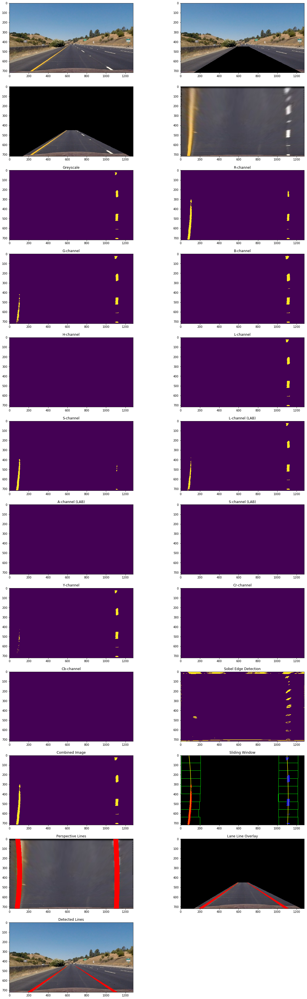

Curvature in pixels is: 1625.06018317:1976.29673077
Curvature in m is: 533.752588921:648.157485143
Pipeline breakdown for straight_lines2.jpg


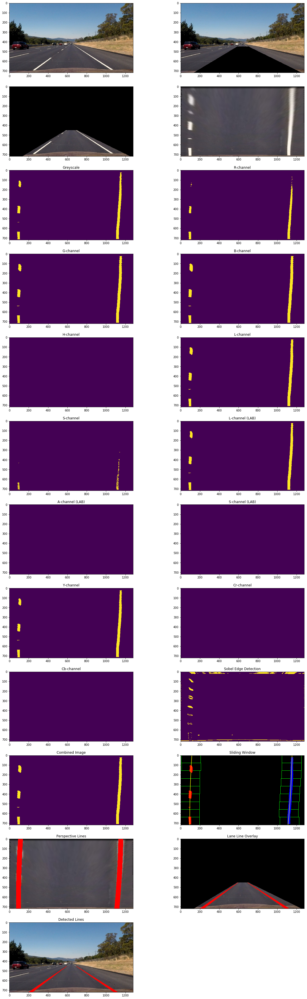

Curvature in pixels is: 1625.06018317:1976.29673077
Curvature in m is: 533.752588921:648.157485143
Pipeline breakdown for test1.jpg


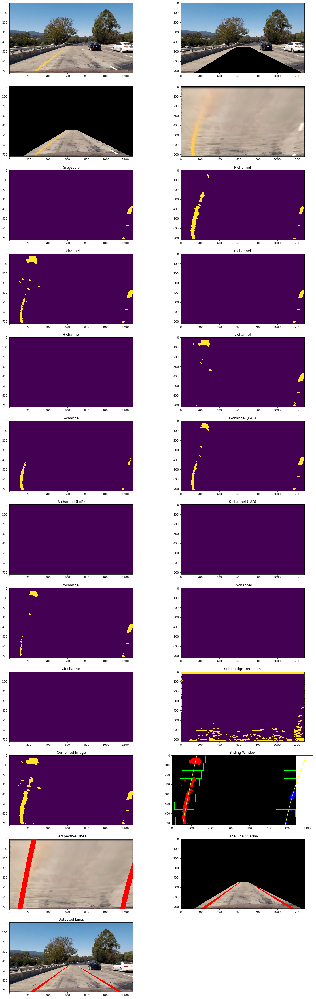

Curvature in pixels is: 1625.06018317:1976.29673077
Curvature in m is: 533.752588921:648.157485143
Pipeline breakdown for test2.jpg


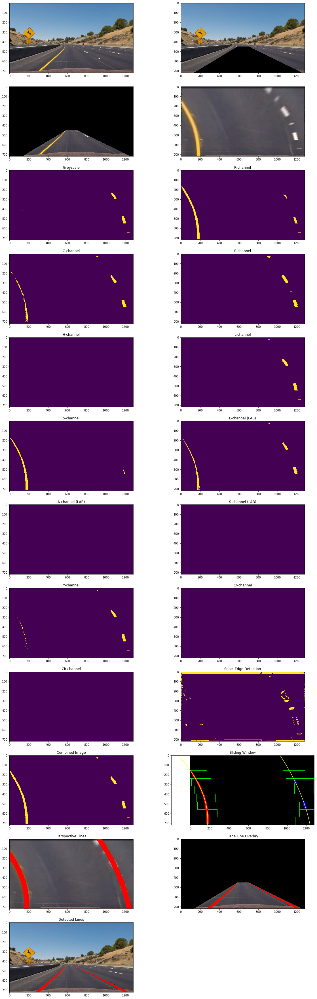

Curvature in pixels is: 1625.06018317:1976.29673077
Curvature in m is: 533.752588921:648.157485143
Pipeline breakdown for test3.jpg


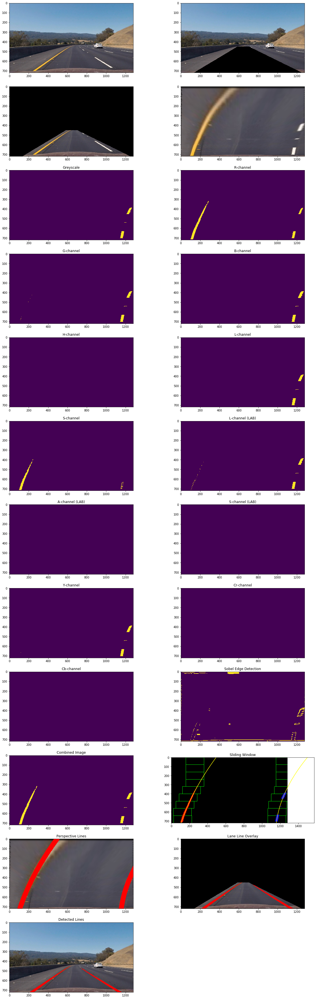

Curvature in pixels is: 1625.06018317:1976.29673077
Curvature in m is: 533.752588921:648.157485143
Pipeline breakdown for test4.jpg


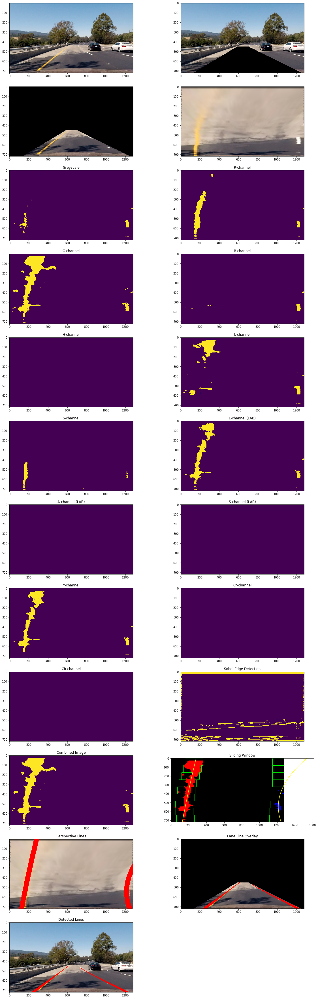

Curvature in pixels is: 1625.06018317:1976.29673077
Curvature in m is: 533.752588921:648.157485143
Pipeline breakdown for test5.jpg


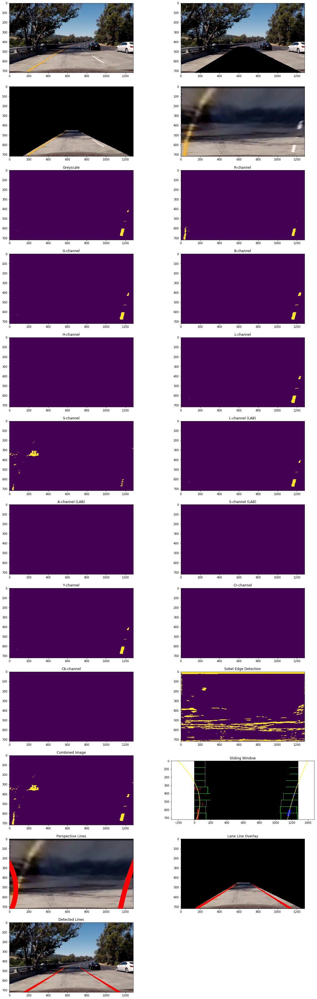

Curvature in pixels is: 1625.06018317:1976.29673077
Curvature in m is: 533.752588921:648.157485143
Pipeline breakdown for test6.jpg


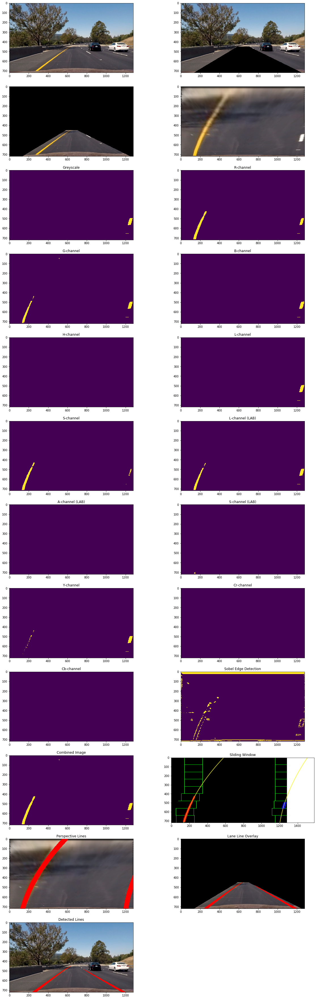

In [6]:
#Multiple analysis and selection of highest probability area

#Read and display static Images with undistortion and perspective transform applied 
#to the area of interest using the simple pipeline from exercise 1

static_image_path = os.getcwd() + '/test_images/'
static_image_path_iterator = os.listdir(static_image_path)

#Configure pipeline arrays
staticImages = []
region_masked_images = []
region_highlighted_images = []
perspective_images = []
perspective_lines = []
detected_lines = []
final_output = []

count = 0
iterationImageCount = 0
for static_image in static_image_path_iterator:
    staticImages.append(cv2.undistort(mpImage.imread(static_image_path + static_image), mtx, dist, None, mtx))

    #Setup region of interest for images using hard coded trapezoidal area
    region_point_1 = [135,720] 
    region_point_2 = [1250,720]
    region_point_3 = [585,450]
    region_point_4 = [700,450]
    line_A = np.polyfit((region_point_3[0], region_point_1[0]), (region_point_3[1], region_point_1[1]), 1)
    line_B = np.polyfit((region_point_3[0], region_point_4[0]), (region_point_3[1], region_point_4[1]), 1)
    line_C = np.polyfit((region_point_1[0], region_point_2[0]), (region_point_1[1], region_point_2[1]), 1)
    line_D = np.polyfit((region_point_2[0], region_point_4[0]), (region_point_2[1], region_point_4[1]), 1)

    #now loop through and copy defined images in order to delineate the area of interest
    image = staticImages[count]
    (y,x) = (image.shape[0],image.shape[1])

    if (iterationImageCount == 0):
        defaultPlotX = plot.rcParams["figure.figsize"][0] 
        defaultPlotY = plot.rcParams["figure.figsize"][1]
        iterationImageCount = 1
    
    #Generate region masked images
    region_masked_images.append(np.copy(image))
    region_highlighted_images.append(np.copy(image))
    (xx, yy) = np.meshgrid(np.arange(0,x),np.arange(0,y))
    area_of_interest = (yy > (xx*line_A[0]+line_A[1])) & (yy > (xx*line_B[0] + line_B[1])) & (yy < (xx*line_C[0] + line_C[1])) & (yy > (xx*line_D[0]+line_D[1]))
    discarded_area = np.invert(area_of_interest)
    current_image_index = count
    region_masked_images[current_image_index][discarded_area] = [0,0,0]
    region_highlighted_images[current_image_index][area_of_interest] = [0,0,0]
    
    #Generate perspective transformed images
    image = region_masked_images[count]
    pT_img = np.copy(region_masked_images[current_image_index])
    pT_size = (pT_img.shape[1], pT_img.shape[0])
    pT_src = np.float32([[135,720],[1250,720],[585,450],[700,450]])
    pT_dst = np.float32([[0,720],[1280,720],[0,0],[1280,0]])
    pTransform = cv2.getPerspectiveTransform(pT_src, pT_dst)
    perspective_images.append(cv2.warpPerspective(pT_img, pTransform, pT_size, flags=cv2.INTER_LINEAR))
    
    #Generate Gray, RGB, HLS, LAB and YCrCb channels
    image = perspective_images[count]
    thresh = (210, 255)
    r_thresh = (230, 255)
    g_thresh = (199, 255)
    b_thresh = (190, 255)
    hls_thresh = (200, 255)
    lab_thresh = (210, 255)
    ycb_thresh = (205, 255)
    grey = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    grey_binary = np.zeros_like(grey)
    grey_binary[(grey > thresh[0]) & (grey <= thresh[1])] = 1
    r = image[:,:,0]
    r_binary = np.zeros_like(r)
    r_binary[(r>r_thresh[0]) & (r<=r_thresh[1])] = 1
    g = image[:,:,1]
    g_binary = np.zeros_like(g)
    g_binary[(g>g_thresh[0]) & (g<=g_thresh[1])] = 1
    b = image[:,:,2]
    b_binary = np.zeros_like(b)
    b_binary[(b>b_thresh[0]) & (b<=b_thresh[1])] = 1
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    h = hls[:,:,0]
    h_binary = np.zeros_like(h)
    h_binary[(h>hls_thresh[0]) & (h<=hls_thresh[1])] = 1
    l = hls[:,:,1]
    l_binary = np.zeros_like(h)
    l_binary[(l>hls_thresh[0]) & (l<=hls_thresh[1])] = 1
    s = hls[:,:,2]
    s_binary = np.zeros_like(h)
    s_binary[(s>thresh[0]) & (s<=thresh[1])] = 1
    LAB = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    l_lab = LAB[:,:,0]
    l_lab_binary = np.zeros_like(l_lab)
    l_lab_binary[(l_lab>lab_thresh[0]) & (l_lab<=lab_thresh[1])] = 1
    a_lab = LAB[:,:,1]
    a_lab_binary = np.zeros_like(a_lab)
    a_lab_binary[(a_lab>lab_thresh[0]) & (a_lab<=lab_thresh[1])] = 1
    b_lab = LAB[:,:,2]
    b_lab_binary = np.zeros_like(b_lab)
    b_lab_binary[(b_lab>lab_thresh[0]) & (b_lab<=lab_thresh[1])] = 1
    YCB = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
    y_ycb = YCB[:,:,0]
    y_binary = np.zeros_like(y_ycb)
    y_binary[(y_ycb>ycb_thresh[0]) & (y_ycb<=ycb_thresh[1])] = 1
    cr = YCB[:,:,1]
    cr_binary = np.zeros_like(cr)
    cr_binary[(cr>ycb_thresh[0]) & (cr<=ycb_thresh[1])] = 1
    cb = YCB[:,:,2]
    cb_binary = np.zeros_like(cb)
    cb_binary[(cb>ycb_thresh[0]) & (cb<=ycb_thresh[1])] = 1
    
    #Compute Sobel
    sobel = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    mag_thresh=(30, 100)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(sobel, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(sobel, cv2.CV_64F, 0, 1, ksize=21)
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    binary_sobel = np.zeros_like(gradmag)
    binary_sobel[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    
    #Now generate the combined image based on the binary channels which had the highest hit rate in testing with thresholds
    #RGB - Red and Green 
    #HLS - L and S
    #LAB - L
    #YCrCb - Y
    #Sobel Edge if there is a low probability of noise
    
    high_prob_lane_lines = np.zeros_like(r_binary)
    high_prob_lane_lines[(r_binary > 0)] = 1
    high_prob_lane_lines[(g_binary > 0)] = 1
    high_prob_lane_lines[(l_binary > 0)] = 1
    high_prob_lane_lines[(s_binary > 0)] = 1
    high_prob_lane_lines[(l_lab_binary > 0)] = 1
    high_prob_lane_lines[(y_binary > 0)] = 1
    
    #Find lines using the sliding window method
    histogram = np.sum(high_prob_lane_lines[high_prob_lane_lines.shape[0]//2:,:], axis=0)
    out_img = np.dstack((high_prob_lane_lines, high_prob_lane_lines, high_prob_lane_lines))
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    nwindows = 9
    margin = 100
    minpix = 50
    window_height = np.int(high_prob_lane_lines.shape[0]//nwindows)
    nonzero = high_prob_lane_lines.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    leftx_current = leftx_base
    rightx_current = rightx_base
    left_lane_inds = []
    right_lane_inds = []
    # Slide through the windows
    for window in range(nwindows):
        win_y_low = high_prob_lane_lines.shape[0] - (window+1)*window_height
        win_y_high = high_prob_lane_lines.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        pass

    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    ploty = np.linspace(0, high_prob_lane_lines.shape[0]-1, high_prob_lane_lines.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        print('Unable to fit line')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    #Generate data around fit lines in order to measure curvature
    np.random.seed(0)
    ploty = np.linspace(0, 719, num=720)
    quadratic_coeff = 3e-4 
    leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                    for y in ploty])
    rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                    for y in ploty])
    leftx = leftx[::-1] 
    rightx = rightx[::-1] 
    left_fit = np.polyfit(ploty, leftx, 2)
    right_fit = np.polyfit(ploty, rightx, 2)
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    y_eval = np.max(ploty)
    
    # Calculation of curvature
    left_curverad_pixels = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad_pixels = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    print("Curvature in pixels is: " + str(left_curverad_pixels) + ":" + str(right_curverad_pixels))
    
    left_curverad_m = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad_m = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    print("Curvature in m is: " + str(left_curverad_m) + ":" + str(right_curverad_m))
    
    #Finally take our fitted lines and place them back on the original untransformed image
    perspective_lines.append(np.copy(perspective_images[count]))
    line1 = np.array([left_fitx,ploty])
    line1 = line1.T
    line1 = np.array(line1,np.int32)
    line1 = line1.reshape((-1,1,2))
    line2 = np.array([right_fitx,ploty])
    line2 = line2.T
    line2 = np.array(line2,np.int32)
    line2 = line2.reshape((-1,1,2))
    cv2.polylines(perspective_lines[count], [line1], False, (255,0,0),50)
    cv2.polylines(perspective_lines[count], [line2], False, (255,0,0),50)
    
    pT_dst = np.float32([[135,720],[1250,720],[585,450],[700,450]])
    pT_src = np.float32([[0,720],[1280,720],[0,0],[1280,0]])
    pTransform = cv2.getPerspectiveTransform(pT_src, pT_dst)
    detected_lines.append(cv2.warpPerspective(perspective_lines[count], pTransform, pT_size, flags=cv2.INTER_LINEAR))
    
    #Overlay onto the 
    final_image = region_highlighted_images[current_image_index]
    final_image = cv2.addWeighted(final_image, 1, detected_lines[count], 1, 0)
    final_output.append(final_image)
    
    
    # Display image transformation pipeline
    print('Pipeline breakdown for ' + static_image)
    total_width_inches = (x + 150)/f.dpi
    total_height_inches = (y + 50)/f.dpi
    plot.rcParams["figure.figsize"][0] = total_width_inches
    plot.rcParams["figure.figsize"][1] = total_height_inches * 6
    numRows = 12
    numCols = 2
    f = plot.figure()
    f.add_subplot(numRows,numCols,1)
    plot.imshow(staticImages[current_image_index])
    f.add_subplot(numRows,numCols,2)
    plot.imshow(region_highlighted_images[current_image_index])
    f.add_subplot(numRows,numCols,3)
    plot.imshow(region_masked_images[current_image_index])
    f.add_subplot(numRows,numCols,4)
    plot.imshow(perspective_images[current_image_index])
    a = f.add_subplot(numRows,numCols,5)
    a.set_title('Greyscale')
    plot.imshow(grey_binary)
    a = f.add_subplot(numRows,numCols,6)
    a.set_title('R-channel')
    plot.imshow(r_binary)
    a = f.add_subplot(numRows,numCols,7)
    a.set_title('G-channel')
    plot.imshow(g_binary)
    a = f.add_subplot(numRows,numCols,8)
    a.set_title('B-channel')
    plot.imshow(b_binary)
    a = f.add_subplot(numRows,numCols,9)
    a.set_title('H-channel')
    plot.imshow(h_binary)
    a = f.add_subplot(numRows,numCols,10)
    a.set_title('L-channel')
    plot.imshow(l_binary)
    a = f.add_subplot(numRows,numCols,11)
    a.set_title('S-channel')
    plot.imshow(s_binary)
    a = f.add_subplot(numRows,numCols,12)
    a.set_title('L-channel (LAB)')
    plot.imshow(l_lab_binary)
    a = f.add_subplot(numRows,numCols,13)
    a.set_title('A-channel (LAB)')
    plot.imshow(a_lab_binary)
    a = f.add_subplot(numRows,numCols,14)
    a.set_title('S-channel (LAB)')
    plot.imshow(b_lab_binary)
    a = f.add_subplot(numRows,numCols,15)
    a.set_title('Y-channel')
    plot.imshow(y_binary)
    a = f.add_subplot(numRows,numCols,16)
    a.set_title('Cr-channel')
    plot.imshow(cr_binary)
    a = f.add_subplot(numRows,numCols,17)
    a.set_title('Cb-channel')
    plot.imshow(cb_binary)
    a = f.add_subplot(numRows,numCols,18)
    a.set_title('Sobel Edge Detection')
    plot.imshow(binary_sobel)
    a = f.add_subplot(numRows,numCols,19)
    a.set_title('Combined Image')
    plot.imshow(high_prob_lane_lines)
    a = f.add_subplot(numRows,numCols,20)
    a.set_title('Sliding Window')
    plot.imshow(out_img)
    plot.plot(left_fitx, ploty, color='yellow')
    plot.plot(right_fitx, ploty, color='yellow')
    a = f.add_subplot(numRows,numCols,21)
    a.set_title('Perspective Lines')
    plot.imshow(perspective_lines[count])
    a = f.add_subplot(numRows,numCols,22)
    a.set_title('Lane Line Overlay')
    plot.imshow(detected_lines[count])
    a = f.add_subplot(numRows,numCols,23)
    a.set_title('Detected Lines')
    plot.imshow(final_output[count])
    figurePixelSize = f.get_size_inches() * f.dpi
    figureInchesSize = f.get_size_inches()
    plot.show()
    
    #Reset plot points
    plot.rcParams["figure.figsize"][0] = total_width_inches
    plot.rcParams["figure.figsize"][1] = total_height_inches
    
    #Move to next image
    count = count + 1
    

#### Step 3 - Additional Optimisations

The above process highlights the method of determining lane lines using advanced methods. The process above was able to generate a high quality image without resorting to using the Sobel operator as the additional color spaces provided enough accurate data to determine the lane lines.

In the test cases where the road is quite light and matches the color spaces, however, more advanced methods will need to be employed such as glare detection and reduction and increasing the contrast of images as a pre-processing step. These additional optimisations won't be explored in this exercise however and will be undertaken separately.

The pipeline as defined above is also inefficient and can be sped up if a more robust image processing method were used.